In [1]:
import warnings
warnings.filterwarnings("ignore")

import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import scvi

# rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
import seaborn as sns
import cell2location
from cell2location.utils.filtering import filter_genes
from cell2location.models import RegressionModel
from cell2location.plt import plot_spatial
import anndata as ad
from scipy.stats import spearmanr
from string import ascii_uppercase

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=300, facecolor='white')

scanpy==1.9.6 anndata==0.10.3 umap==0.5.5 numpy==1.26.2 scipy==1.11.4 pandas==2.1.4 scikit-learn==1.3.2 statsmodels==0.14.1 igraph==0.11.3 pynndescent==0.5.11


In [48]:
outdir = "./lung_data/"
cancer = "Lung"
# outdir = "./ovarian_data/"
# cancer = "Ovarian"

## 给Predicted ST miRNA数据建立Anndata数据结构，增加细胞类型信息

In [49]:
adata_vis = sc.read_h5ad(outdir+cancer+"_analysis/cell2location_map/sp.h5ad")
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

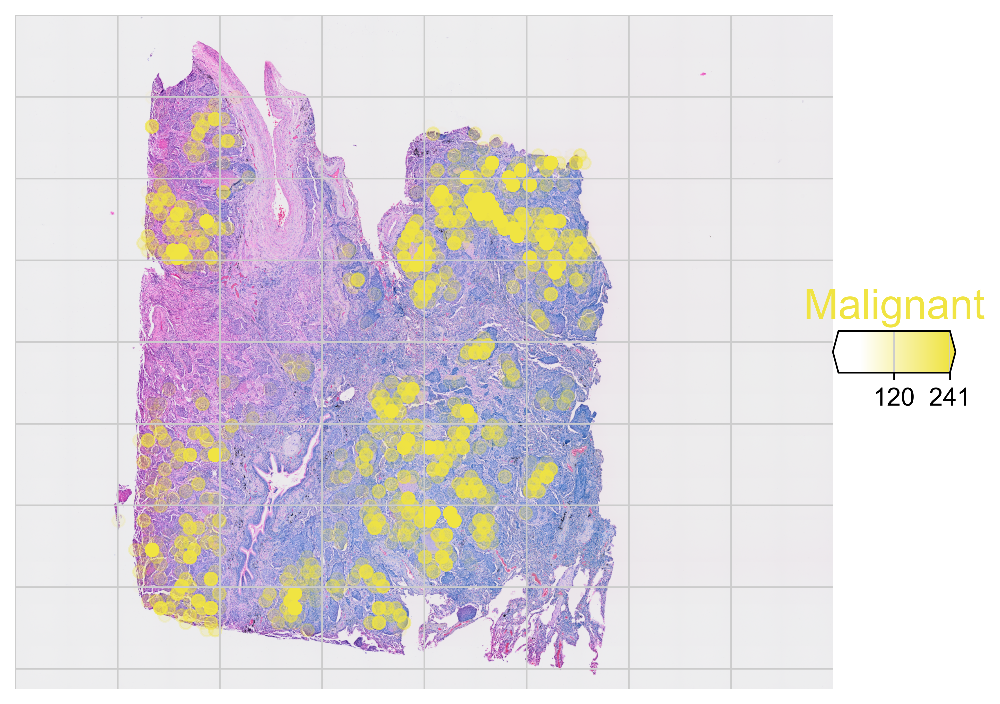

In [50]:
# Now we use cell2location plotter that allows showing multiple cell types in one panel
def Visual_Malignant(adata_vis):
    adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']
    
    clust_labels = ['Malignant']
    clust_col = ['' + str(i) for i in clust_labels] # in case column names differ from labels
    
    with mpl.rc_context({'figure.figsize': (8, 8)}):
        fig = plot_spatial(
            adata_vis,
            # labels to show on a plot
            color=clust_col, labels=clust_labels,
            show_img=True,
            # 'fast' (white background) or 'dark_background'
            style='fast',
            # limit color scale at 99.2% quantile of cell abundance
            max_color_quantile=0.992,
            # size of locations (adjust depending on figure size)
            circle_diameter=6,
            colorbar_position='right'
        )

Visual_Malignant(adata_vis)

In [51]:
sp_mrna = sc.read_h5ad(outdir+cancer+'_mrna.h5ad')
pre_mirna = pd.read_csv(outdir+'Pre'+cancer+'st_mirna.csv',index_col=0)

In [52]:
def Build_STmirna(mirna,sp_mrna):
    mirna = mirna.rank(axis=1, ascending=True, method='min')
    obs_names = mirna.index.to_list()
    obs = pd.DataFrame(index=obs_names)
    # 设置特征名
    var_names = mirna.columns.to_list()
    # 特征数量
    n_vars = len(var_names)
    # 特征注释数据框
    var = pd.DataFrame(index=var_names)
    # 生成数据矩阵
    X = mirna.values
    
    # 初始化 AnnData 对象
    # AnnoData 对象默认使用数据类型为 `float32`, 可以更精确的存储数据
    mirna_adata = ad.AnnData(X, obs=obs, var=var, dtype='int32')
    #使用spatial mRNA的空间位置等信息
    mirna_adata.uns = sp_mrna.uns
    mirna_adata.obsm = sp_mrna.obsm
    mirna_adata.obs['clusters'] = sp_mrna.obs['clusters']
    return mirna_adata

def Add_celltype(adata_vis,sp_mirna,sp_mrna):
    #取共同样本
    intersect = np.intersect1d(adata_vis.obs_names, sp_mirna.obs_names)
    sp_mrna = adata_vis[intersect]
    #选择最大值的作为spot主细胞类型
    print(adata_vis.obs.columns[7:])
    sp_mrna.obs['celltype'] = sp_mrna.obs[adata_vis.obs.columns[7:]].idxmax(axis=1)
    #给miRNA数据增加细胞类型信息
    sp_mirna.obs['celltype'] = sp_mrna.obs['celltype']
    sp_mirna.write(outdir+cancer+'_mirna.h5ad')
    return sp_mirna

In [53]:
sp_mirna = Build_STmirna(pre_mirna,sp_mrna)
sp_mirna = Add_celltype(adata_vis,sp_mirna,sp_mrna)

Index(['Alveolar', 'B', 'CD4Tconv', 'CD8T', 'CD8Tex', 'Endothelial',
       'Fibroblasts', 'Malignant', 'Mast', 'Mono/Macro', 'Plasma', 'Treg'],
      dtype='object')


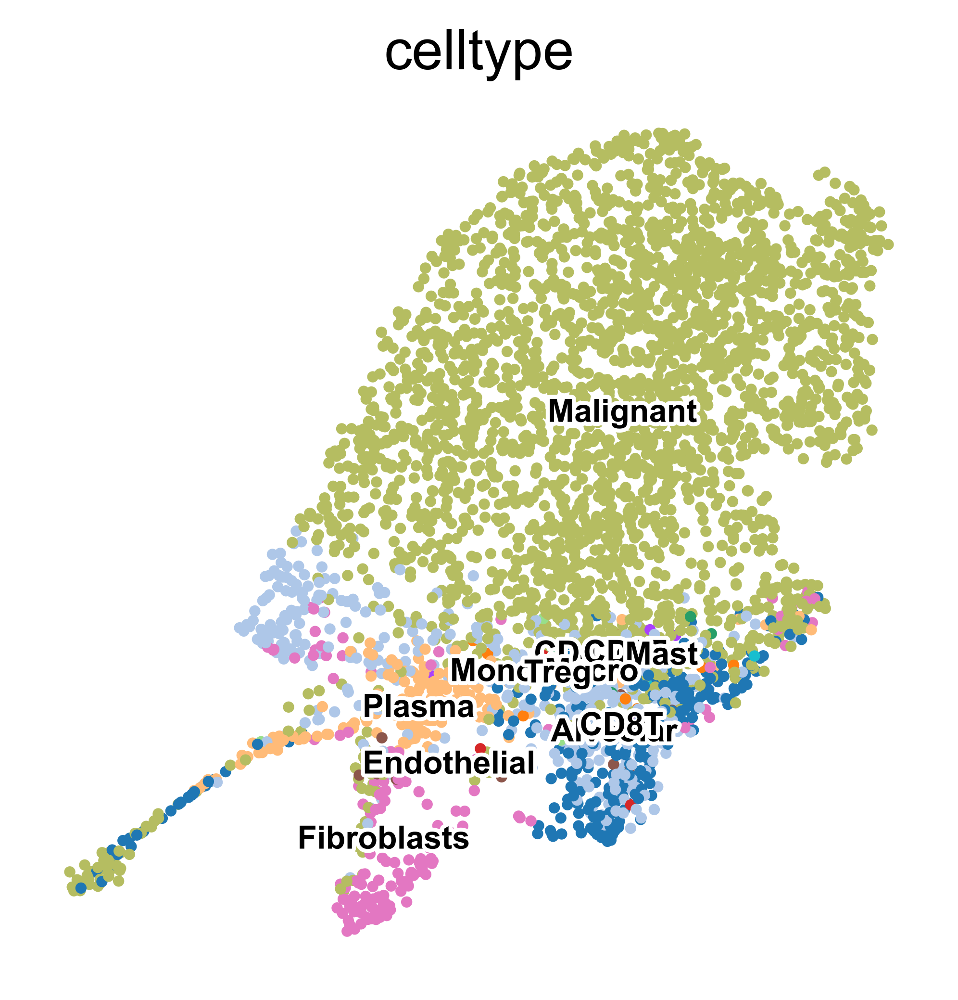

In [54]:
sc.pl.umap(sp_mirna,
    color="celltype", legend_loc='on data',
           frameon=False, legend_fontsize=8, legend_fontoutline=2
)

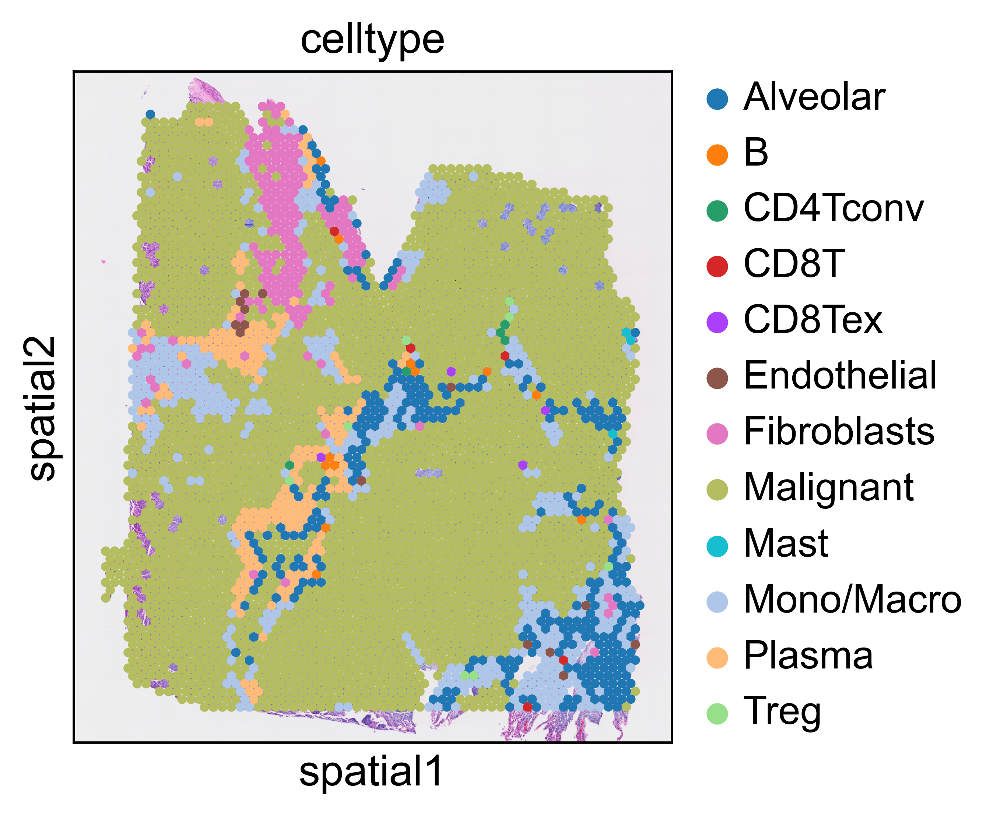

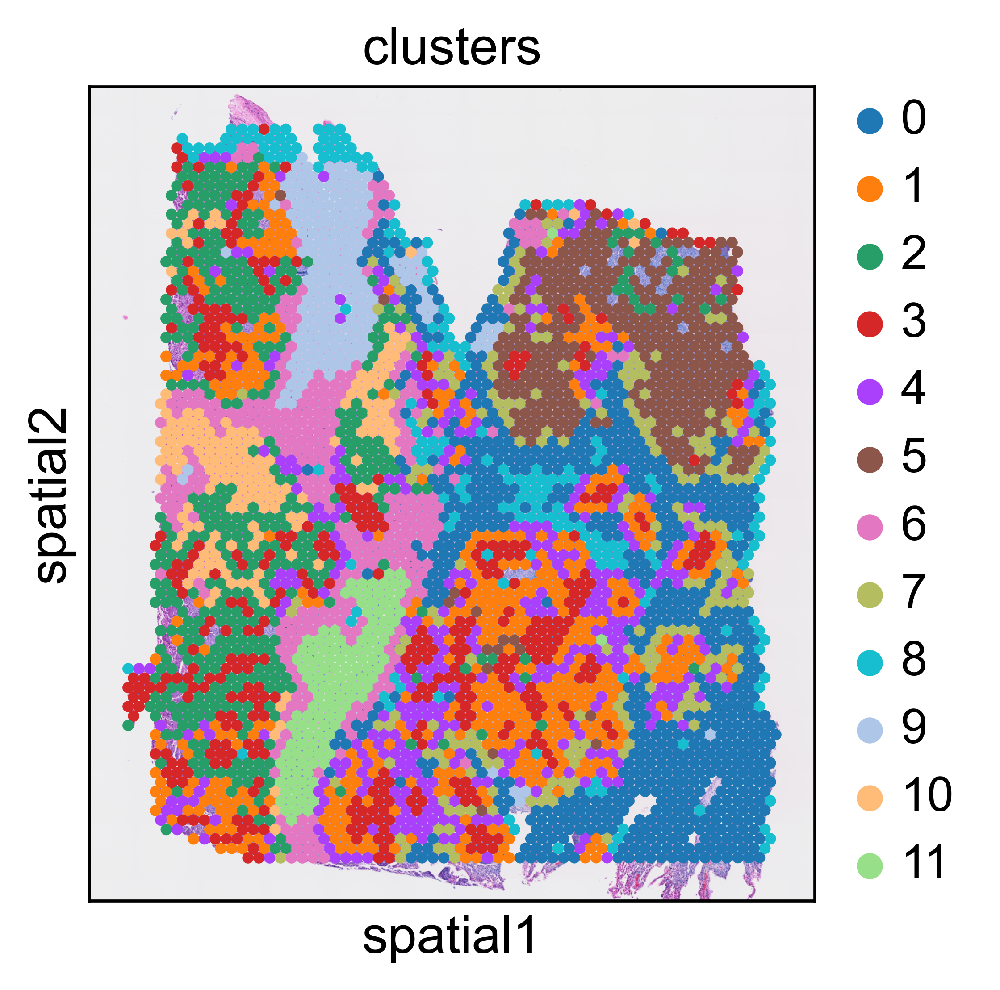

In [55]:
sc.pl.spatial(sp_mirna,img_key="hires", color="celltype",size=1.5)
sc.pl.spatial(sp_mirna,img_key="hires", color="clusters",size=1.5)

## 差异分析找出malignant spot中高表达的miRNA

In [56]:
def Find_top(sp_mirna,Celltype):
    sc.tl.rank_genes_groups(sp_mirna, 'celltype', method='wilcoxon')
    sc.pl.rank_genes_groups(sp_mirna, n_genes=10)
    
    # find all degs
    celltype = sp_mirna.obs['celltype'].unique().tolist() #把所有细胞簇种类拿出来
    deg = sc.get.rank_genes_groups_df(sp_mirna,group=celltype) #把所有细胞簇对应的deg拿出来
    # deg.to_csv(outdir+cancer+'_malig_DEG.csv') #存储备份
    
    groups = deg.groupby('group') 
    top10 = groups.get_group(Celltype).sort_values('scores',ascending=False).head(10)
    top10 = top10["names"]
    return top10

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


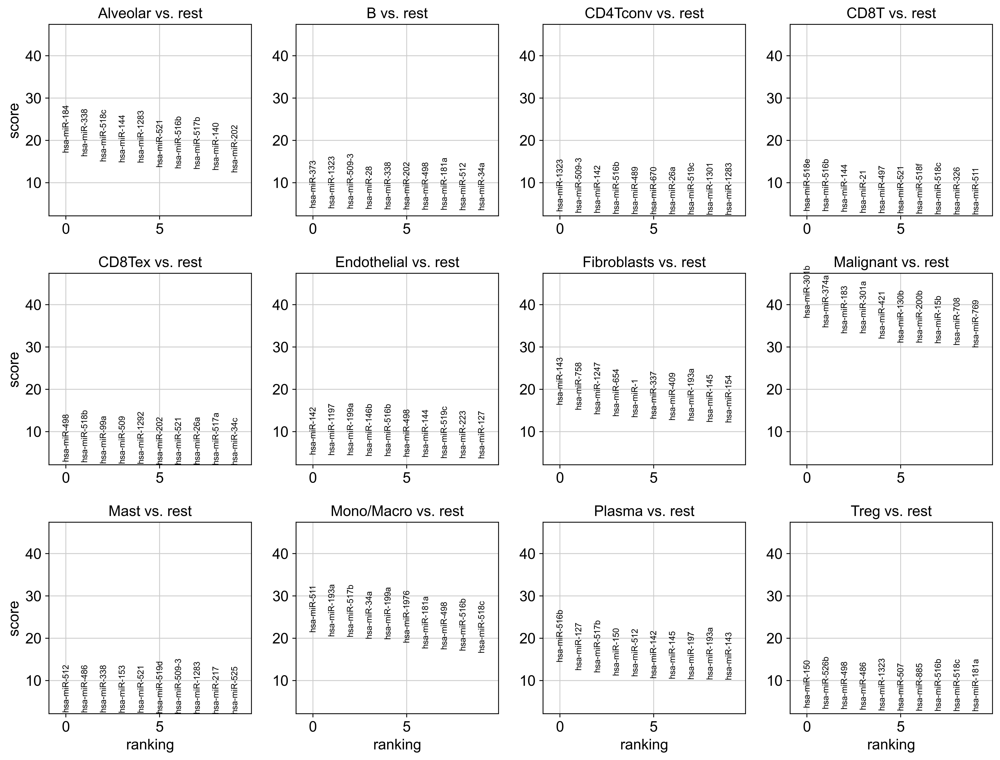

0    hsa-miR-301b
1    hsa-miR-374a
2     hsa-miR-183
3    hsa-miR-301a
4     hsa-miR-421
5    hsa-miR-130b
6    hsa-miR-200b
7     hsa-miR-15b
8     hsa-miR-708
9     hsa-miR-769
Name: names, dtype: object

In [57]:
top10 = Find_top(sp_mirna,"Malignant")
top10

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_celltype']`


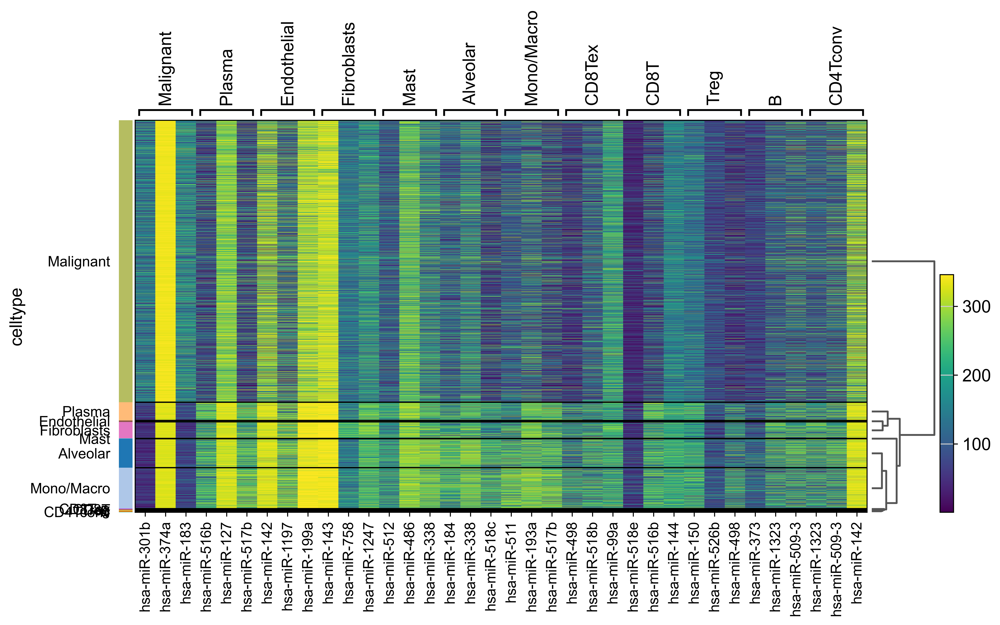

In [58]:
sc.pl.rank_genes_groups_heatmap(sp_mirna, n_genes=3, groupby="celltype")